# Описание файлов проекта

Описание файлов проекта:

Для тренировки всех моделей в проекте используется класс Training (размещен в файле training.py). Написан с использованием IGNITE (https://github.com/pytorch/ignite).

Основной момент - это использование планировщиков LR. Класс позволяет тренировать модели с использоваием

StepLR(optimizer=self.optimizer, step_size=1, gamma=0.7)

и

OneCycleLR(self.optimizer, max_lr=0.1, pct_start=0.2, total_steps=len(self.train_loader) * self.num_epochs,div_factor=25,final_div_factor=10))

или не используя планировщик. Переключение между ними осуществляется с помощью задания первых трех букв имени модели (не очень удобно, но работает). Если имя модели начинается с 'Vit', то работает StepLR, если имя 'VIT', то 'OneCycleLR', если имя другое, то ни один из них не используется. Класс позволяет выводит метрики и логи в тензорборд.

Класс модели VIT - VisionTransformer (размещен в файле model.py). Код не претендует на оригинальность, тк писался для того чтобы лучше понять работу модели и возможность реализовать 2D (абсолютные) позиционные эмбеддинги, а также гибридную модель.

(2D эмбеддинги изначально были в задании. К сожалению, информацию нашел только об относительных 2D эмбеддингах, поэтому не знаю верно ли их реализовал. Прироста качества при тренировке они не дают.)

В папке проекта содержаться следующие папки:

tb_logs_vit_vgg_pre - логи для тензорборда тренировки моделей 1ой части проекта на датасете Plants,

tb_logs_vit_vgg_pre_dc - логи для тензорборда тренировки моделей 1ой части проекта на датасете Dog vs Cats,

saved model - с файлами сохраненных моделей из 3й части проекта,

tb_log_vit_resvit - логи для тензорборда тренировки обычной и гибридной модели,

tb_log_vit_new - лог для тензорборда модели vit_new из 3й части проекта.

Архивы датвсетов:

224_200.zip - датасет Plants, этот датасет был создан из фотогрвфий использованных в реальном проекте по определению болезней растений в боксах для их выращивания.

dogs-vs-cats-redux-kernels-edition.zip

# Visual Transformer(part 3)
https://paperswithcode.com/paper/an-image-is-worth-16x16-words-transformers-1

Github links:

* [google-research/vision_transformer](https://github.com/google-research/vision_transformer)
*  [lucidrains/vit-pytorch](https://github.com/lucidrains/vit-pytorch)
* [lukemelas/PyTorch-Pretrained-ViT](https://github.com/lukemelas/PyTorch-Pretrained-ViT)

## Задание
По 3 части у вас есть выбор:
1. Обучить модель с нуля - это был изначальный план проекта
2. Произвести анализ моделей:<br>
*  модель ResNet + VIt, ResNet можете заменить любой другой моделью, главное, чтобы модель была гибридная
*  обычный ViT

Нас интересует следующее: достаточно ли обычного линейного преобразование над патчами для успешной классификации, либо требуется сначала получить скрытое представление патча с помощью, например, ResNet.
Первый и второй пункт проверить на датасете CIFAR100. Начальный шаг для 3 части второго пункта уже есть в ноутбуке ViT-3.

## Import Libraries

In [1]:
from __future__ import print_function

import glob
from itertools import chain
import os
import random

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

from PIL import Image
from sklearn.model_selection import train_test_split
from torch.optim.lr_scheduler import StepLR
from torch.utils.data import DataLoader, Dataset
from torchvision import datasets, transforms
from tqdm.notebook import tqdm
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [2]:
!pip install git+https://github.com/pytorch/ignite

  Cloning https://github.com/pytorch/ignite to /tmp/pip-req-build-qsgek0ru
  Running command git clone -q https://github.com/pytorch/ignite /tmp/pip-req-build-qsgek0ru
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for pytorch-ignite: filename=pytorch_ignite-0.5.0-cp37-none-any.whl size=227585 sha256=4a6d356725d1083f05dd10338b2212cef84cb4b064fdd761a256394664bedc73
  Stored in directory: /tmp/pip-ephem-wheel-cache-8rfdf_zh/wheels/92/9a/cd/39c0bc302c48329ecbe3a0d8b56678725a25332c7e9100d3b5
Successfully built pytorch-ignite


In [3]:

!cp /content/gdrive/'My Drive'/Goncharov_Alexey_VIT_project/training.py .
!cp /content/gdrive/'My Drive'/Goncharov_Alexey_VIT_project/model.py .

In [4]:
seed = 42
def seed_everything(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True

seed_everything(seed)
device = 'cuda'

## Data

In [5]:
# Загрузка данных

transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.507, 0.487, 0.441], std=[0.267, 0.256, 0.276])
])
dataset = datasets.CIFAR10(root="./", train=True, download=True, transform=transform)
torch.manual_seed(0)
trainset, valset = torch.utils.data.random_split(dataset, [45000, 5000], )
testset = datasets.CIFAR10(root="./", train=False, download=True, transform=transform)


Extracting ./cifar-10-python.tar.gz to ./
Files already downloaded and verified


In [6]:
vars(dataset).keys()

dict_keys(['root', 'transform', 'target_transform', 'transforms', 'train', 'data', 'targets', 'classes', 'class_to_idx'])

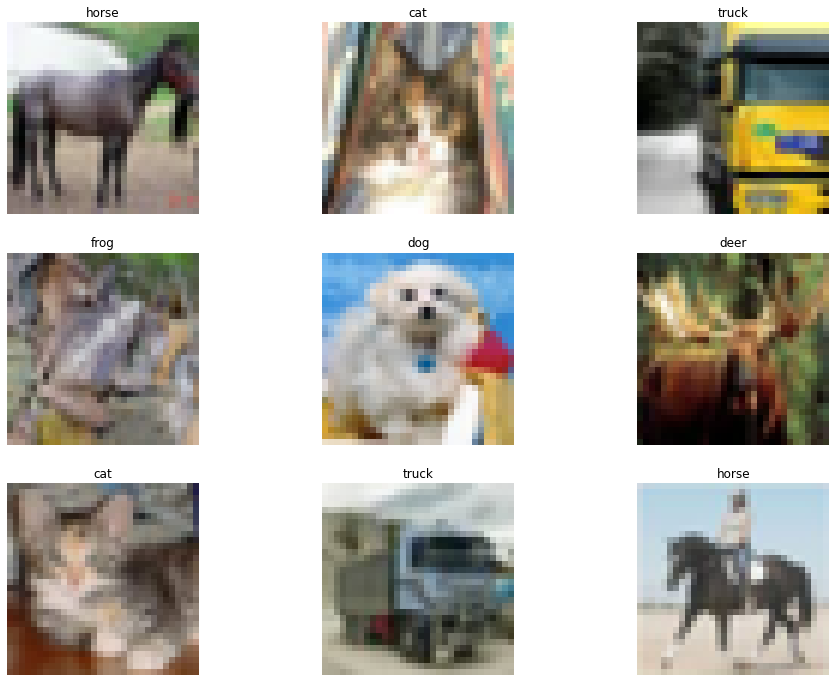

In [7]:
# Картинки из датасета

random_idx = np.random.randint(1, len(trainset.indices), size=9)

fig, axes = plt.subplots(3, 3, figsize=(16, 12))

for idx, ax in enumerate(axes.ravel()):
   target =  trainset.dataset.targets[random_idx[idx]]
   label = trainset.dataset.classes[target]
   img = trainset.dataset.data[random_idx[idx]]
   ax.set_title(label)
   ax.axis('off')
   ax.imshow(img)

In [8]:
# Даталоудеры

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'using {device} mode')

batch_size = 32
train_loader = torch.utils.data.DataLoader(trainset, batch_size=batch_size, shuffle=True, num_workers=2)
valid_loader = torch.utils.data.DataLoader(valset, batch_size=batch_size, num_workers=2)
test_loader = torch.utils.data.DataLoader(testset, batch_size=batch_size, num_workers=2)

using cuda mode


In [9]:
len(train_loader), len(valid_loader), len(test_loader)

(1407, 157, 313)

In [10]:
# Вспомогательные функции

from termcolor import colored

colors = ['red', 'green', 'blue', 'yellow']

def model_structure(layer, margin=0, item_color=0, deep=0, max_deep=2):
    for name, next_layer in layer.named_children():
        if deep > max_deep:
            return
        next = (0 if not list(next_layer.named_children()) else 1)
        print(colored(' ' * margin + name, colors[item_color]) + ':' * next)
        model_structure(next_layer, margin + len(name) + 2, (item_color + 1) % 4, deep + 1, max_deep=max_deep)

def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)        

## lr_scheduler OneCycleLR

/usr/local/lib/python3.7/dist-packages/torch/optim/lr_scheduler.py:134: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  "https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate", UserWarning)


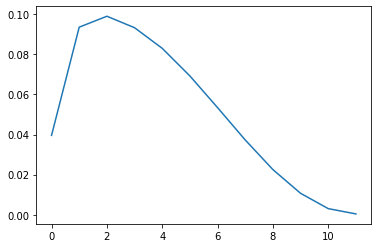

In [62]:
# Здесь для наглядности привёл график lr_scheduler OneCycleLR c параметрами установленными 
# в файле trainning.py
# По этому графику будет меняться lr при обучении моделей VIT и VIT RES

model = torch.nn.Linear(2, 1)
optimizer = torch.optim.SGD(model.parameters(), lr=0)
epochs_ = 12
scheduler = torch.optim.lr_scheduler.OneCycleLR(optimizer, 
                                                max_lr=0.1,
                                                pct_start=0.2, 
                                                total_steps= len(train_loader) * epochs_,
                                                div_factor=25,
                                                final_div_factor=10)
lrs = []
for i in range(1, epochs_ + 1):
    for j in range(1, len(train_loader) + 1):
          scheduler.step()
    optimizer.step()
    lrs.append(optimizer.param_groups[0]["lr"])    

plt.plot(lrs)
plt.show()

In [ ]:
!kill 1176

## Training

### Tensorboard 

In [39]:
%reload_ext tensorboard
%tensorboard --logdir "/content/tb_log_vit_resvit"

Output hidden; open in https://colab.research.google.com to view.

In [12]:
# Подключение файлов класса модели трансформера и трениннга.
# Класс модели написан по мотивам различных реализаций и не претендует на оригинальность.
# Было сделано для лучшего понимания и попытки реализовать 2D эмбеддинги и гибридную модель.
# (В классе есть возможность сделать 2D абсолютные эмбеддинги у модели поставив параметр 
# pos_1d=False. Однако прироста к итоговому качеству при треннировки он не дает.)

import model
import imp 
imp.reload(model)
from model import VisionTransformer

In [52]:
import training
import imp 
imp.reload(training)
from training import Training

### VIT training

In [17]:
# Создаём модель трансформера

vit = VisionTransformer(depth=12,
                        n_heads=12,
                        img_size=224,
                        dim=768,
                        patch_size=16, 
                        pos_1d=True,
                        hybr=False, 
                        n_classes=10) 

model_structure(vit, max_deep=2)
print(f'The model has {count_parameters(vit):,} trainable parameters')

emb_proj
blocks:
        0:
           qkv
           attn_drop
           proj
           block_drop
           mlp:
           block_norm1
           block_norm2
        1:
           qkv
           attn_drop
           proj
           block_drop
           mlp:
           block_norm1
           block_norm2
        2:
           qkv
           attn_drop
           proj
           block_drop
           mlp:
           block_norm1
           block_norm2
        3:
           qkv
           attn_drop
           proj
           block_drop
           mlp:
           block_norm1
           block_norm2
        4:
           qkv
           attn_drop
           proj
           block_drop
           mlp:
           block_norm1
           block_norm2
        5:
           qkv
           attn_drop
           proj
           block_drop
           mlp:
           block_norm1
           block_norm2
        6:
           qkv
           attn_drop
           proj
           block_drop
           mlp:



Model VIT epoch 1/15 : 1407, lr: 0.028010,  train loss: 1.865



Model VIT epoch 1/15 : 157, lr: 0.028010,  valid loss: 1.977,  valid accuracy: 0.376



Model VIT epoch 2/15 : 2814, lr: 0.076021,  train loss: 1.616



Model VIT epoch 2/15 : 157, lr: 0.076021,  valid loss: 1.882,  valid accuracy: 0.395



Model VIT epoch 3/15 : 4221, lr: 0.100000,  train loss: 1.503



Model VIT epoch 3/15 : 157, lr: 0.100000,  valid loss: 1.605,  valid accuracy: 0.460



Model VIT epoch 4/15 : 5628, lr: 0.098301,  train loss: 1.224



Model VIT epoch 4/15 : 157, lr: 0.098301,  valid loss: 1.918,  valid accuracy: 0.420



Model VIT epoch 5/15 : 7035, lr: 0.093323,  train loss: 1.413



Model VIT epoch 5/15 : 157, lr: 0.093323,  valid loss: 1.520,  valid accuracy: 0.511



Model VIT epoch 6/15 : 8442, lr: 0.085407,  train loss: 1.374



Model VIT epoch 6/15 : 157, lr: 0.085407,  valid loss: 1.414,  valid accuracy: 0.533



Model VIT epoch 7/15 : 9849, lr: 0.075092,  train loss: 1.211



Model VIT epoch 7/15 : 157, lr: 0.075092,  valid loss: 1.414,  valid accuracy: 0.550



Model VIT epoch 8/15 : 11256, lr: 0.063080,  train loss: 1.172



Model VIT epoch 8/15 : 157, lr: 0.063080,  valid loss: 1.367,  valid accuracy: 0.568



Model VIT epoch 9/15 : 12663, lr: 0.050191,  train loss: 1.125



Model VIT epoch 9/15 : 157, lr: 0.050191,  valid loss: 1.372,  valid accuracy: 0.575



Model VIT epoch 10/15 : 14070, lr: 0.037302,  train loss: 1.091



Model VIT epoch 10/15 : 157, lr: 0.037302,  valid loss: 1.265,  valid accuracy: 0.611



Model VIT epoch 11/15 : 15477, lr: 0.025292,  train loss: 0.944



Model VIT epoch 11/15 : 157, lr: 0.025292,  valid loss: 1.264,  valid accuracy: 0.617



Model VIT epoch 12/15 : 16884, lr: 0.014980,  train loss: 0.845



Model VIT epoch 12/15 : 157, lr: 0.014980,  valid loss: 1.294,  valid accuracy: 0.631



Model VIT epoch 13/15 : 18291, lr: 0.007067,  train loss: 0.678



Model VIT epoch 13/15 : 157, lr: 0.007067,  valid loss: 1.324,  valid accuracy: 0.641



Model VIT epoch 14/15 : 19698, lr: 0.002094,  train loss: 0.547



Model VIT epoch 14/15 : 157, lr: 0.002094,  valid loss: 1.481,  valid accuracy: 0.635



Model VIT epoch 15/15 : 21105, lr: 0.000400,  train loss: 0.427



Model VIT epoch 15/15 : 157, lr: 0.000400,  valid loss: 1.784,  valid accuracy: 0.638



Model VIT epoch 15/15 : 313, test accuracy : 0.64
 airplane recall : 0.69,       airplane precision : 0.70
 automobile recall : 0.73,     automobile precision : 0.73
 bird recall : 0.58,           bird precision : 0.50
 cat recall : 0.46,            cat precision : 0.42
 deer recall : 0.60,           deer precision : 0.61
 dog recall : 0.53,            dog precision : 0.59
 frog recall : 0.71,           frog precision : 0.70
 horse recall : 0.65,          horse precision : 0.68
 ship recall : 0.74,           ship precision : 0.76
 truck recall : 0.71,          truck precision : 0.73


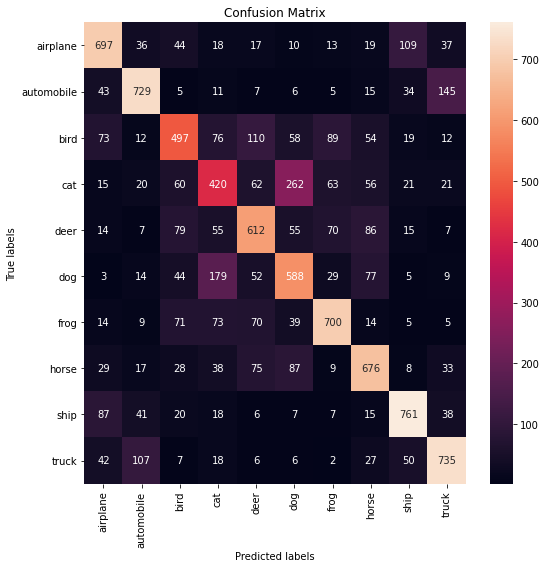

In [18]:
# Здесь обучение модели с lr_scheduler OneCycleLR
# Итоговое качество которое удалось получить:
# Model VIT epoch 15/15 : 313, test accuracy : 0.64

torch.cuda.empty_cache()
training_vit = Training(device=device, 
                        model=vit.to(device), 
                        name='VIT', 
                        log_dir='tb_log_vit_resvit') 

# определяем оптимайзер
params = [p for p in training_vit.model.parameters() if p.requires_grad]
optimizer = optim.SGD([{"params": params[-2:], "lr": 3e-3},
                       {"params": params[:-2], "lr": 2e-5}])
clip = 1
num_epoch = 15
criterion = nn.CrossEntropyLoss()
training_vit.load_config(optimizer, criterion, num_epoch, train_loader, valid_loader, test_loader, 
                  dataset.classes, clip=clip)
training_vit.run_training_loop()

### RES VIT training

In [28]:
# Создаём модель трансформера без первого свёрточного слоя который
# делит картинку на патчи, тк это будет гибридная модель, и 
# вход уже будет подаваться карта после свёртки. Устанавливаем 
# patch_size=14, тк из resnet18 размер карты будет 14 на 14. 

vit_ = VisionTransformer(depth=12,
                         n_heads=12,
                         img_size=196,    
                         dim=768,
                         patch_size=14, 
                         pos_1d=True,
                         hybr=True, 
                         n_classes=10) 

In [29]:
# Загружаем resnet18

from torchvision.models import resnet18
res = resnet18(pretrained=False)

In [30]:
# Меняем целиком последний блок resnet18 на свёрточный слой
# Conv2d(256, 768,(1, 1)) c количеством фильтров на выходе
# равным размеру эмбеддингов в VIT, те 768.
# kernel_size ставим (1,1), тк на входе будет карта (14, 14) уже
# соответствующая размеру патча VIT. 
# Убираем слои классификатора из списка слоёв resnet18

l_res = list(res.children())
l_res[7] = nn.Conv2d(256, 768,(1, 1))
res_ = nn.Sequential(*l_res[:-2])

In [32]:
# Класс для гибридной модели

class ResVit(nn.Module):
    def __init__(self, vit, res):
        super().__init__()
        self.res = res
        self.vit = vit
        
    def forward(self, x):
        x = self.res(x)
        x = self.vit(x)
        return x    
        
res_vit = ResVit(vit_, res_)        

In [33]:
res_vit

ResVit(
  (res): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

In [34]:
model_structure(res_vit, max_deep=3)
print(f'The model has {count_parameters(res_vit):,} trainable parameters')

res:
     0
     1
     2
     3
     4:
        0:
           conv1
           bn1
           relu
           conv2
           bn2
        1:
           conv1
           bn1
           relu
           conv2
           bn2
     5:
        0:
           conv1
           bn1
           relu
           conv2
           bn2
           downsample:
        1:
           conv1
           bn1
           relu
           conv2
           bn2
     6:
        0:
           conv1
           bn1
           relu
           conv2
           bn2
           downsample:
        1:
           conv1
           bn1
           relu
           conv2
           bn2
     7
vit:
     blocks:
             0:
                qkv
                attn_drop
                proj
                block_drop
                mlp:
                block_norm1
                block_norm2
             1:
                qkv
                attn_drop
                proj
                block_drop
                mlp:
        

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)



Model VIT RES epoch 1/12 : 1407, lr: 0.039595,  train loss: 1.644



Model VIT RES epoch 1/12 : 157, lr: 0.039595,  valid loss: 1.662,  valid accuracy: 0.467



Model VIT RES epoch 2/12 : 2814, lr: 0.093588,  train loss: 1.149



Model VIT RES epoch 2/12 : 157, lr: 0.093588,  valid loss: 1.484,  valid accuracy: 0.530



Model VIT RES epoch 3/12 : 4221, lr: 0.099041,  train loss: 0.869



Model VIT RES epoch 3/12 : 157, lr: 0.099041,  valid loss: 1.018,  valid accuracy: 0.677



Model VIT RES epoch 4/12 : 5628, lr: 0.093322,  train loss: 0.720



Model VIT RES epoch 4/12 : 157, lr: 0.093322,  valid loss: 0.832,  valid accuracy: 0.724



Model VIT RES epoch 5/12 : 7035, lr: 0.083027,  train loss: 0.652



Model VIT RES epoch 5/12 : 157, lr: 0.083027,  valid loss: 0.691,  valid accuracy: 0.756



Model VIT RES epoch 6/12 : 8442, lr: 0.069247,  train loss: 0.546



Model VIT RES epoch 6/12 : 157, lr: 0.069247,  valid loss: 0.770,  valid accuracy: 0.768



Model VIT RES epoch 7/12 : 9849, lr: 0.053446,  train loss: 0.480



Model VIT RES epoch 7/12 : 157, lr: 0.053446,  valid loss: 0.602,  valid accuracy: 0.801



Model VIT RES epoch 8/12 : 11256, lr: 0.037300,  train loss: 0.390



Model VIT RES epoch 8/12 : 157, lr: 0.037300,  valid loss: 0.632,  valid accuracy: 0.806



Model VIT RES epoch 9/12 : 12663, lr: 0.022523,  train loss: 0.509



Model VIT RES epoch 9/12 : 157, lr: 0.022523,  valid loss: 0.599,  valid accuracy: 0.835



Model VIT RES epoch 10/12 : 14070, lr: 0.010684,  train loss: 0.200



Model VIT RES epoch 10/12 : 157, lr: 0.010684,  valid loss: 0.672,  valid accuracy: 0.850



Model VIT RES epoch 11/12 : 15477, lr: 0.003039,  train loss: 0.083



Model VIT RES epoch 11/12 : 157, lr: 0.003039,  valid loss: 0.781,  valid accuracy: 0.856



Model VIT RES epoch 12/12 : 16884, lr: 0.000400,  train loss: 0.063



Model VIT RES epoch 12/12 : 157, lr: 0.000400,  valid loss: 0.954,  valid accuracy: 0.855



Model VIT RES epoch 12/12 : 313, test accuracy : 0.86
 airplane recall : 0.85,       airplane precision : 0.86
 automobile recall : 0.93,     automobile precision : 0.94
 bird recall : 0.81,           bird precision : 0.76
 cat recall : 0.74,            cat precision : 0.74
 deer recall : 0.83,           deer precision : 0.86
 dog recall : 0.80,            dog precision : 0.78
 frog recall : 0.89,           frog precision : 0.89
 horse recall : 0.89,          horse precision : 0.89
 ship recall : 0.91,           ship precision : 0.91
 truck recall : 0.91,          truck precision : 0.93


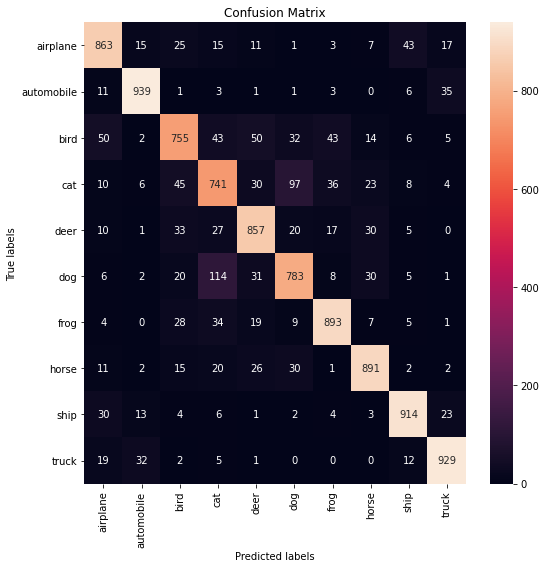

In [36]:
# Обучаем модель с тем же lr_scheduler OneCycleLR что и обучали обычный VIT
# Итоговый результат на тесте (при этом количество эпох меньше на 3!)
# Model VIT RES epoch 12/12 : 313, test accuracy : 0.86

torch.cuda.empty_cache()
training_vit_res = Training(device=device, 
                            model=res_vit.to(device), 
                            name='VIT RES', 
                            log_dir='tb_log_vit_resvit') 

# определяем оптимайзер
params = [p for p in training_vit_res.model.parameters() if p.requires_grad]
optimizer = optim.SGD([{"params": params[-2:], "lr": 3e-3},
                       {"params": params[:-2], "lr": 2e-5}])
clip = 1
num_epoch = 12
criterion = nn.CrossEntropyLoss()
training_vit_res.load_config(optimizer, criterion, num_epoch, train_loader, valid_loader, test_loader, 
                             dataset.classes, clip=clip)
training_vit_res.run_training_loop()

## Attempts to train VIT 

In [53]:
# Делал попытки сначала доубучить обученный VIT на том же датасете, но
# используя планировщик StepLR c изначально установленными параметрами
# step_size=1 и gamma=0.7. С начальным Lr равному последнему его значению
# которое было при прошлой тренировке модели.


vit_old = VisionTransformer(depth=12,
                            n_heads=12,
                            img_size=224,
                            dim=768,
                            patch_size=16, 
                            pos_1d=True,
                            hybr=False, 
                            n_classes=10) 

In [57]:
vit_old.load_state_dict(torch.load('saved_models/VIT_valid accuracy=0.6406.pt'))

<All keys matched successfully>


Model Vit old epoch 1/3 : 1407, lr: 0.000100,  train loss: 0.449



Model Vit old epoch 1/3 : 157, lr: 0.000100,  valid loss: 1.563,  valid accuracy: 0.644



Model Vit old epoch 2/3 : 2814, lr: 0.000070,  train loss: 0.381



Model Vit old epoch 2/3 : 157, lr: 0.000070,  valid loss: 1.869,  valid accuracy: 0.638



Model Vit old epoch 3/3 : 4221, lr: 0.000049,  train loss: 0.360



Model Vit old epoch 3/3 : 157, lr: 0.000049,  valid loss: 1.991,  valid accuracy: 0.635



Model Vit old epoch 3/3 : 313, test accuracy : 0.63
 airplane recall : 0.68,       airplane precision : 0.66
 automobile recall : 0.71,     automobile precision : 0.73
 bird recall : 0.58,           bird precision : 0.50
 cat recall : 0.44,            cat precision : 0.44
 deer recall : 0.57,           deer precision : 0.64
 dog recall : 0.52,            dog precision : 0.57
 frog recall : 0.70,           frog precision : 0.69
 horse recall : 0.67,          horse precision : 0.65
 ship recall : 0.76,           ship precision : 0.74
 truck recall : 0.72,          truck precision : 0.71


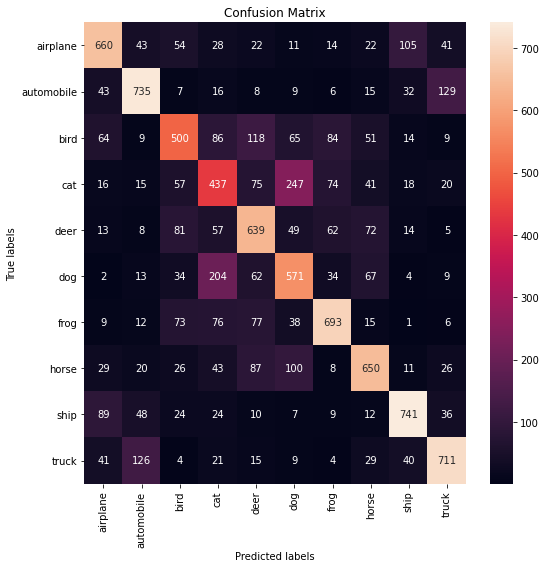

In [58]:
# Обучение не принесло сильного улучшения результата
# Model Vit old epoch 3/3 : 313, test accuracy : 0.63
# Но в ходе обучения valid accurasy до 0.644


training_vit_old = Training(device=device, 
                            model=vit_old.to(device), 
                            name='Vit old',
                            log_dir='tb_log_vit_old')  
# определяем оптимайзер
params = [p for p in training_vit_old.model.parameters() if p.requires_grad]
optimizer = optim.Adam([{"params": params[-2:], "lr": 1e-4},
                       {"params": params[:-2], "lr":  1e-5}])
clip = 1
num_epoch = 3
criterion = nn.CrossEntropyLoss()
training_vit_old.load_config(optimizer, criterion, num_epoch, train_loader, valid_loader, test_loader, 
                             dataset.classes, clip=clip)
training_vit_old.run_training_loop()

In [60]:
# Вторая попытка (вообще то это была самая первая попытка тренировки VIT),
# с начальным StepLR c изначально установленными параметрами step_size=1 и gamma=0.7.

new_vit = VisionTransformer(depth=12,
                            n_heads=12,
                            img_size=224,
                            dim=768,
                            patch_size=16, 
                            pos_1d=True,
                            hybr=False, 
                            n_classes=10) 

In [63]:
%reload_ext tensorboard
%tensorboard --logdir "/content/tb_log_vit_new"

Output hidden; open in https://colab.research.google.com to view.


Model Vit new epoch 1/12 : 1407, lr: 0.003000,  train loss: 1.399



Model Vit new epoch 1/12 : 157, lr: 0.003000,  valid loss: 1.672,  valid accuracy: 0.440



Model Vit new epoch 2/12 : 2814, lr: 0.002100,  train loss: 1.314



Model Vit new epoch 2/12 : 157, lr: 0.002100,  valid loss: 1.454,  valid accuracy: 0.534



Model Vit new epoch 3/12 : 4221, lr: 0.001470,  train loss: 1.184



Model Vit new epoch 3/12 : 157, lr: 0.001470,  valid loss: 1.541,  valid accuracy: 0.544



Model Vit new epoch 4/12 : 5628, lr: 0.001029,  train loss: 1.025



Model Vit new epoch 4/12 : 157, lr: 0.001029,  valid loss: 1.346,  valid accuracy: 0.577



Model Vit new epoch 5/12 : 7035, lr: 0.000720,  train loss: 1.081



Model Vit new epoch 5/12 : 157, lr: 0.000720,  valid loss: 1.339,  valid accuracy: 0.600



Model Vit new epoch 6/12 : 8442, lr: 0.000504,  train loss: 0.891



Model Vit new epoch 6/12 : 157, lr: 0.000504,  valid loss: 1.300,  valid accuracy: 0.609



Model Vit new epoch 7/12 : 9849, lr: 0.000353,  train loss: 0.925



Model Vit new epoch 7/12 : 157, lr: 0.000353,  valid loss: 1.200,  valid accuracy: 0.630



Model Vit new epoch 8/12 : 11256, lr: 0.000247,  train loss: 0.867



Model Vit new epoch 8/12 : 157, lr: 0.000247,  valid loss: 1.207,  valid accuracy: 0.636



Model Vit new epoch 9/12 : 12663, lr: 0.000173,  train loss: 0.756



Model Vit new epoch 9/12 : 157, lr: 0.000173,  valid loss: 1.241,  valid accuracy: 0.641



Model Vit new epoch 10/12 : 14070, lr: 0.000121,  train loss: 0.802



Model Vit new epoch 10/12 : 157, lr: 0.000121,  valid loss: 1.259,  valid accuracy: 0.638



Model Vit new epoch 11/12 : 15477, lr: 0.000085,  train loss: 0.732



Model Vit new epoch 11/12 : 157, lr: 0.000085,  valid loss: 1.284,  valid accuracy: 0.642



Model Vit new epoch 12/12 : 16884, lr: 0.000059,  train loss: 0.697



Model Vit new epoch 12/12 : 157, lr: 0.000059,  valid loss: 1.252,  valid accuracy: 0.643



Model Vit new epoch 12/12 : 313, test accuracy : 0.64
 airplane recall : 0.69,       airplane precision : 0.69
 automobile recall : 0.69,     automobile precision : 0.75
 bird recall : 0.61,           bird precision : 0.49
 cat recall : 0.51,            cat precision : 0.40
 deer recall : 0.56,           deer precision : 0.66
 dog recall : 0.54,            dog precision : 0.56
 frog recall : 0.70,           frog precision : 0.74
 horse recall : 0.67,          horse precision : 0.65
 ship recall : 0.75,           ship precision : 0.75
 truck recall : 0.67,          truck precision : 0.72


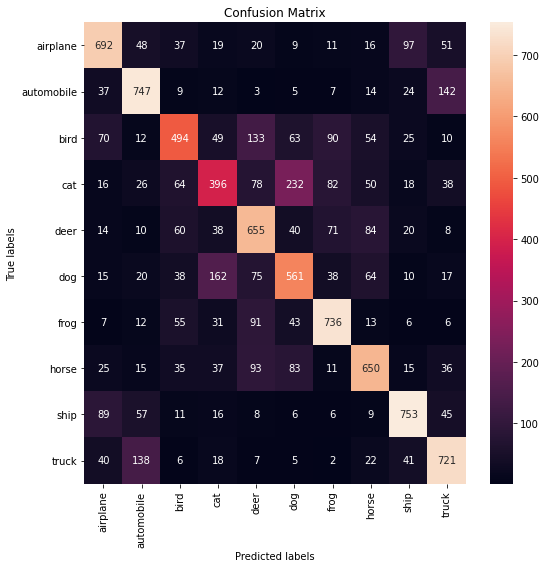

In [61]:
# И её результат в тех же значениях, но за меньшее количество эпох.
# Model Vit new epoch 12/12 : 313, test accuracy : 0.64

training_vit_new = Training(device=device, 
                            model=new_vit.to(device), 
                            name='Vit new',
                            log_dir='tb_log_vit_new')  
# определяем оптимайзер
params = [p for p in training_vit_new.model.parameters() if p.requires_grad]
optimizer = optim.Adam([{"params": params[-2:], "lr": 3e-3},
                        {"params": params[:-2], "lr": 2e-5}])
clip = 1
num_epoch = 12
criterion = nn.CrossEntropyLoss()
training_vit_new.load_config(optimizer, criterion, num_epoch, train_loader, valid_loader, test_loader, 
                             dataset.classes, clip=clip)
training_vit_new.run_training_loop()

## Conclusion

Ниже приведена таблица из статьи "Tokens-to-Token ViT: Training Vision Transformers from Scratch on ImageNet" (https://arxiv.org/pdf/2101.11986.pdf). В ней есть результат тренировки VIT-B16  на датасете ImageNet состоящим из 1,3 миллиона картинок в трейнсете и 50K в валидвционном, при этом модель тренировали 310 эпох и показали 
качество 79,8. Как отмечается в статье, VIT требует для обучения больших датасетов для достижения достойного качества. Возможно из за этого не удалось добиться хорошего качества у модели VIT на данном датасете. На графиках видно, что модель которую тренировали 15 эпох и  использовали lr_scheduler OneCycleLR, после 12 эпохи начала сильно переобучаться, а модель которую тренировали 12 эпох - переобучалась меньше но с 8ой эпохи. Можно это расценивать как маленький размер датасета. Возможно стоило бы попробывать сделать аугументацию картинок, но тк целью было сравнить две модели между собой это сделано не было.


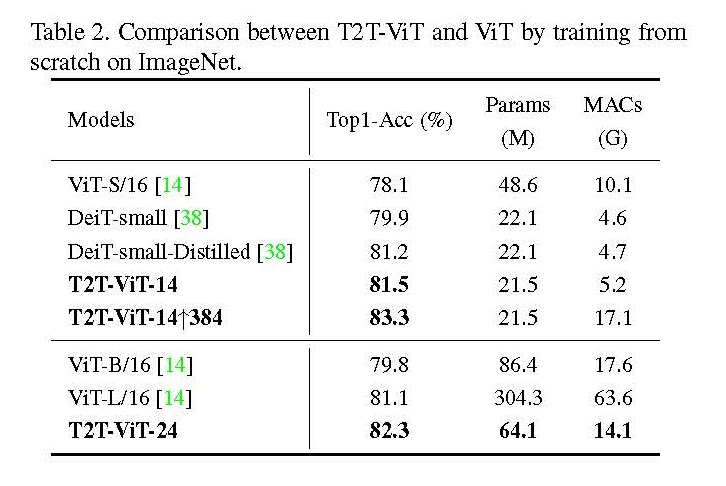

Ещё одно предположение, к вопросу - почему гибридная модель показала лучший результат, так же взята из статьи которая упоминалась выше. На картинке ниже показаны в верхнем ряду карты фичей с различных слоёв Resnet50 и во втором ряду карты фичей 
из токенов различных блоков трансформера (это не карты внимамания!). На картинке отмечены красными границами вырожденные карты с нулевыми или большими значениями. В статье отмечается что у трансформера к последнему блоку плохо доходит информация о структуре вокруг объекта на котором сосредоточено всё внимание, в отличии от  Resnet у которого все карты на последнем слое несут информацию. В нашем случае возможно что Resnet равномернее распределял информацию на картинке перед подачей в трансформер, а тот в свою очередь более равномерно распределял внимание, что сказалось на обучении на малом датасете и привело к лучшим показателям у гибридной модели. 
Напомню полученные в ходе тренировок данные: 
Model VIT RES epoch 12/12 : 313, test accuracy : 0.86
Model VIT epoch 15/15 : 313, test accuracy : 0.64

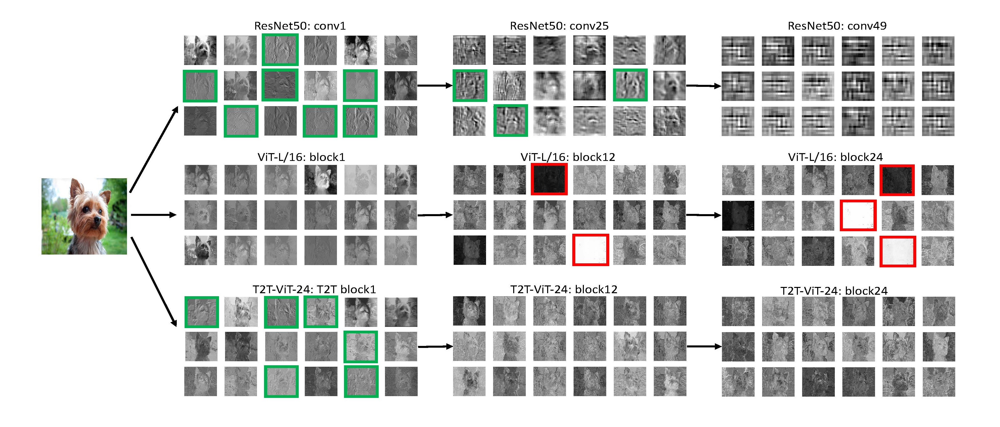